In [1]:
import numpy as np
import joblib
import os, yaml, sys
ENV = os.getenv("MY_ENV", "dev")
with open("../../config.yaml", "r") as f:
    config = yaml.safe_load(f)
paths = config[ENV]["paths"]
sys.path.append(paths["src_path"])
from dim_redu_anns.utils import get_relevant_output_layers, get_layer_out_shape
from pref_viewing.utils import plot_imgs
from alignment.utils import get_usual_transform
from parallel.parallel_funcs import print_wise
from torchvision.models.feature_extraction import (
    create_feature_extractor,
    get_graph_node_names,
)
from torchvision.transforms import ToPILImage
from PIL import Image
from torchvision import models
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from alignment.utils import get_usual_transform
from pref_viewing.utils import get_extreme_k
from datetime import datetime
import torch
from pref_viewing.utils import get_extreme_k
from experiments.images_sampling import save_imgs_PCs, save_imgs_CCs
from experiments.utils import project_onto_PCs, project_onto_CCs, map_on_savenames, get_k_imgs
from dim_redu_anns.utils import get_relevant_output_layers
import pandas as pd

[Tiziano-Causin.local:74167] shmem: mmap: an error occurred while determining whether or not /var/folders/nw/yf48zdjj1m5012281wx_pzhc0000gn/T//ompi.Tiziano-Causin.501/jf.0/2603810816/sm_segment.Tiziano-Causin.501.9b330000.0 could be created.


In [74]:
model_name1 = "resnet50"
model_name2 =  "vit_b_16"#"resnet50"
layers1 = get_relevant_output_layers(model_name1)
layers2 = get_relevant_output_layers(model_name2)
pooling = "PC_pool"
n_CCs = 100



In [89]:
mn = "vit_b_16"
ln = "encoder.layers.encoder_layer_0.add_1"
PCs_path = f"{paths["results_path"]}/imagenet_val_{mn}_{ln}_pca_model_1000_PCs.pkl"
PCs = joblib.load(PCs_path)


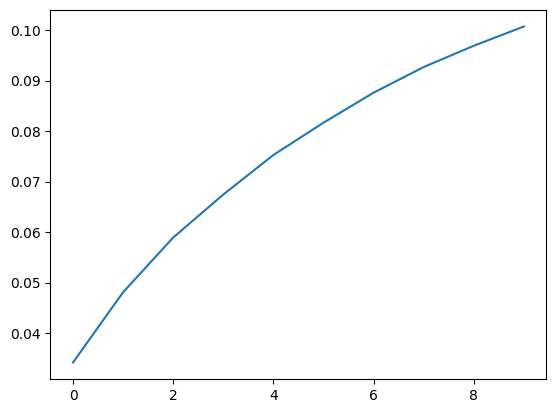

In [92]:
a = np.cumsum(PCs.explained_variance_ratio_)
plt.plot(a[:10])

In [75]:
print(layers2)

['conv_proj', 'encoder.layers.encoder_layer_0.add_1', 'encoder.layers.encoder_layer_2.add_1', 'encoder.layers.encoder_layer_4.add_1', 'encoder.layers.encoder_layer_6.add_1', 'encoder.layers.encoder_layer_8.add_1', 'encoder.layers.encoder_layer_10.add_1', 'encoder.layers.encoder_layer_11.add_1', 'encoder.ln', 'heads.head']


In [81]:
a = np.zeros((len(layers1), len(layers2)))
counter1 = 0
for l1 in layers1:
    counter2 = 0
    for l2 in layers2:
        
        path2CCs = f"{paths['results_path']}/cca_{model_name1}_vs_{model_name2}_{pooling}/cca_{model_name1}_vs_{model_name2}_{n_CCs}_components_pca_{l1}_vs_{l2}.pkl"
    
        try:
            CCs = joblib.load(path2CCs)
            entry = np.mean(CCs['coefs'])
        except FileNotFoundError:
            print("file not found")
            entry = np.nan
        a[counter1, counter2] = entry
        counter2 +=1
    counter1 += 1

file not found
file not found
file not found


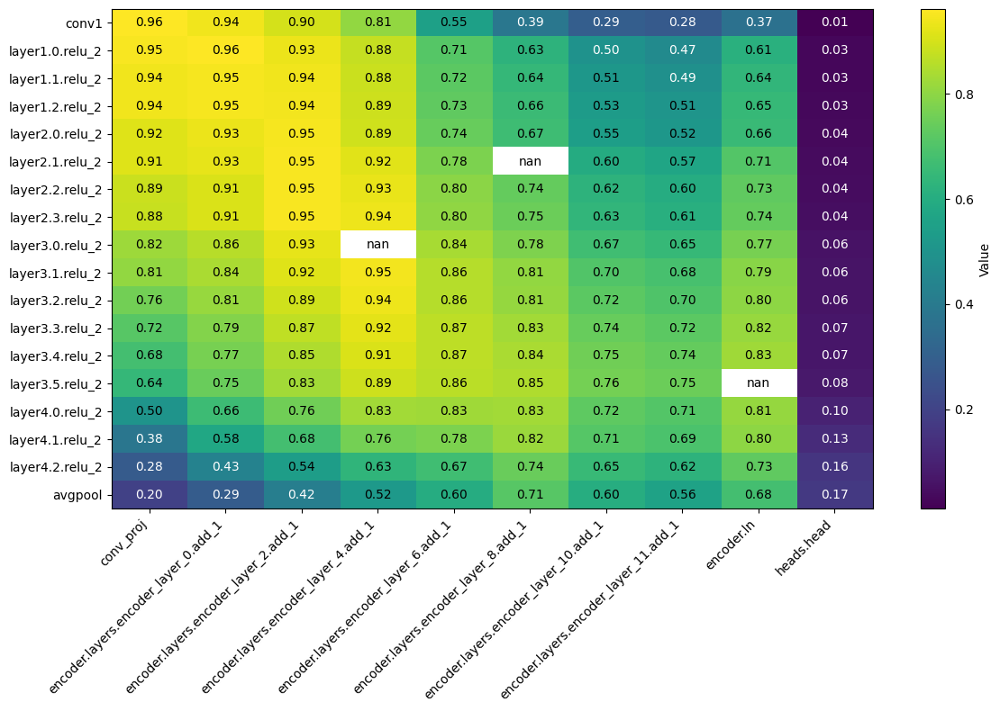

In [82]:
#plt.imshow(a)
plt.figure(figsize=(12, 8)) 
plt.imshow(a, cmap='viridis', aspect='auto')
plt.colorbar(label='Value')
for i in range(a.shape[0]):
    for j in range(a.shape[1]):
        value = a[i, j]
        plt.text(j, i, f'{value:.2f}', ha='center', va='center', color='white' if value < 0.5 else 'black')
#y_labels = get_relevant_output_layers("alexnet")

plt.xticks(ticks=np.arange(len(layers2)), labels=layers2, rotation=45, ha='right')
plt.yticks(ticks=np.arange(len(layers1)), labels=layers1)
plt.tight_layout()

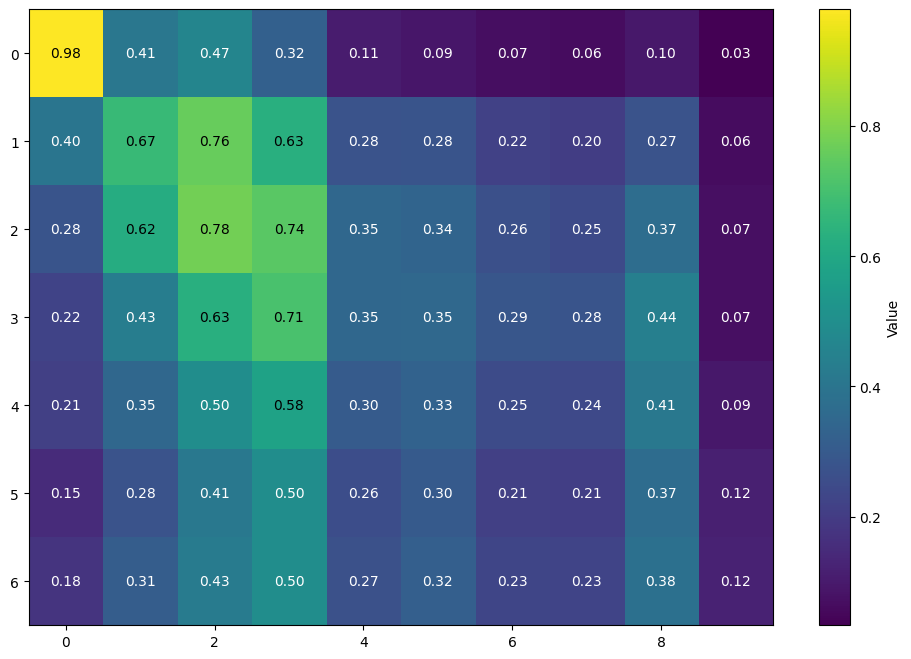

In [56]:
m = np.loadtxt("/Users/tizianocausin/Library/CloudStorage/OneDrive-SISSA/data_repo/exp_set_res/silico/cka_alexnet_vit_b_16_20_batches_gram.csv", delimiter=",")
plt.figure(figsize=(12, 8)) 
plt.imshow(m, cmap='viridis', aspect='auto')
plt.colorbar(label='Value')
for i in range(m.shape[0]):
    for j in range(m.shape[1]):
        value = m[i, j]
        plt.text(j, i, f'{value:.2f}', ha='center', va='center', color='white' if value < 0.5 else 'black')
#y_labels = get_relevant_output_layers("alexnet")


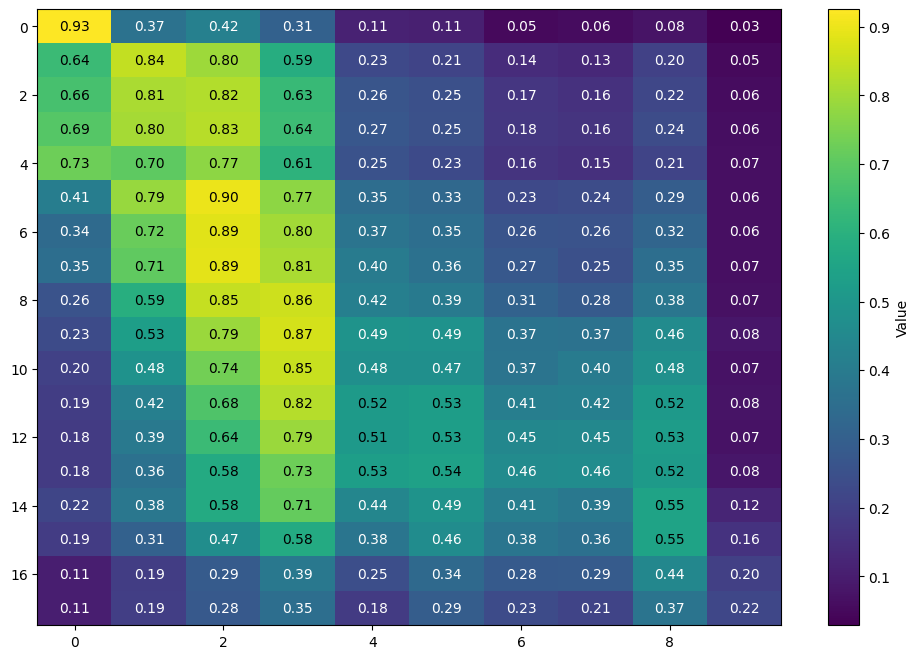

In [57]:

m = np.loadtxt("/Users/tizianocausin/Library/CloudStorage/OneDrive-SISSA/data_repo/exp_set_res/silico/cka_resnet50_vit_b_16_20_batches_gram.csv", delimiter=",")
plt.figure(figsize=(12, 8)) 
plt.imshow(m, cmap='viridis', aspect='auto')
plt.colorbar(label='Value')
for i in range(m.shape[0]):
    for j in range(m.shape[1]):
        value = m[i, j]
        plt.text(j, i, f'{value:.2f}', ha='center', va='center', color='white' if value < 0.5 else 'black')
#y_labels = get_relevant_output_layers("alexnet")

In [58]:
transform = get_usual_transform()
dataset = datasets.ImageFolder(f"{paths["data_path"]}/imagenet/val", transform=transform)

transform_to_show = transforms.Compose(
    [
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
    ]
)
dataset_to_show = datasets.ImageFolder(f"{paths["data_path"]}/imagenet/val", transform=transform_to_show)

In [59]:

#target_layer1, target_layer2 = "features.7", "encoder.layers.encoder_layer_4.add_1"
target_layer1, target_layer2 = "layer3.4.relu_2", "encoder.ln"#"encoder.layers.encoder_layer_4.add_1" #"layer1.0.relu_2", "conv_proj"
pooling = "PC_pool"
d1, d2 = project_onto_CCs(model_name1, model_name2, target_layer1, target_layer2, pooling, 100, paths)

In [60]:
feats_path1 = f"{paths["results_path"]}/imagenet_val_{model_name1}_{target_layer1}_{pooling}_features.pkl"
feats1 = joblib.load(feats_path1)

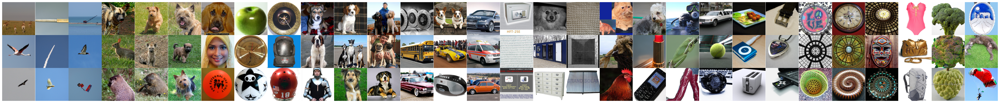

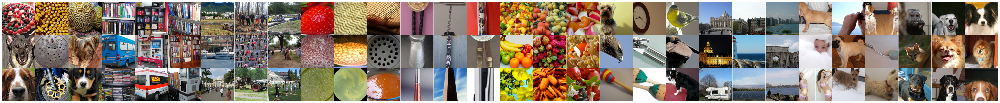

In [98]:
n_dims = 10
k = 9
extremes = ["top", "bottom"]

for extreme in extremes:
    img_list = []
    for d in range(0, 0+n_dims):
        imgs_idx, imgs = get_k_imgs(feats1, dataset_to_show, k, d, extreme)
        imgs = [img.permute(1,2,0) for img in imgs]
        img_list.append(imgs)
    plot_imgs(img_list, multi=True)


In [62]:
#target_layer1 = "encoder.layers.encoder_layer_0.add_1"
feats_path2 = f"{paths["results_path"]}/imagenet_val_{model_name2}_{target_layer2}_{pooling}_features.pkl"
feats2 = joblib.load(feats_path2)

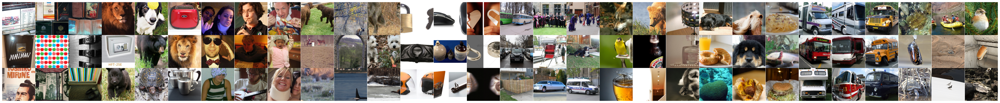

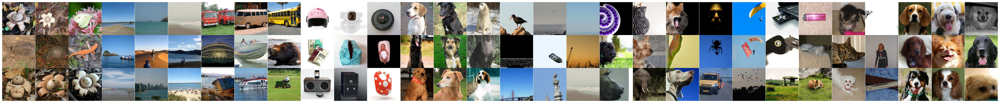

In [99]:
n_dims = 10
k = 9
extremes = ["top", "bottom"]

for extreme in extremes:
    img_list = []
    for d in range(0, 0+n_dims):
        imgs_idx, imgs = get_k_imgs(feats2, dataset_to_show, k, d, extreme)
        imgs = [img.permute(1,2,0) for img in imgs]
        img_list.append(imgs)
    plot_imgs(img_list, multi=True)

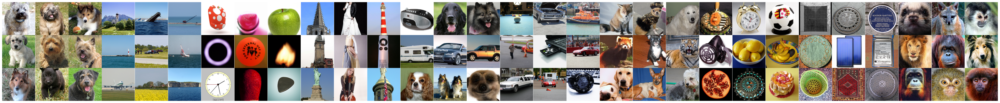

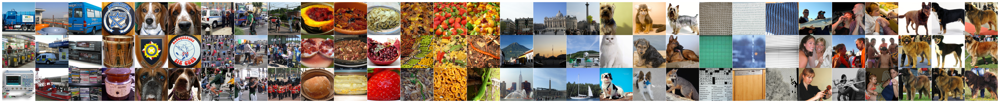

In [100]:
n_dims = 10
k = 9
extremes = ["top", "bottom"]

for extreme in extremes:
    img_list = []
    for d in range(0, 0+n_dims):
        imgs_idx, imgs = get_k_imgs(d1, dataset_to_show, k, d, extreme)
        imgs = [img.permute(1,2,0) for img in imgs]
        img_list.append(imgs)
    plot_imgs(img_list, multi=True)

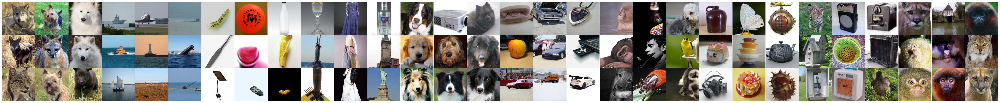

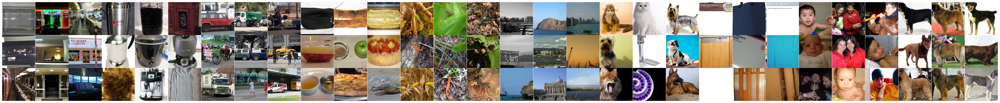

In [101]:
n_dims = 10
k = 9
extremes = ["top", "bottom"]

for extreme in extremes:
    img_list = []
    for d in range(0, 0+n_dims):
        imgs_idx, imgs = get_k_imgs(d2, dataset_to_show, k, d, extreme)
        imgs = [img.permute(1,2,0) for img in imgs]
        img_list.append(imgs)
    plot_imgs(img_list, multi=True)

In [37]:
def get_progression(data, img_num, dim):
    sorted_indices = np.argsort(data[:,dim])  # ascending order
    progression = np.linspace(0, len(sorted_indices) -1, img_num)
    final_idx = []
    for i in progression:
        final_idx.append(sorted_indices[int(i)])
    return final_idx


In [ ]:
dataset_to_show = datasets.ImageFolder(f"{paths["data_path"]}/imagenet/val", transform=transform_to_show)

In [61]:
progr = get_progression(feats2, 11, 1)
img_list = [dataset_to_show[i][0] for i in progr]
imgs = [img.permute(1,2,0) for img in img_list]

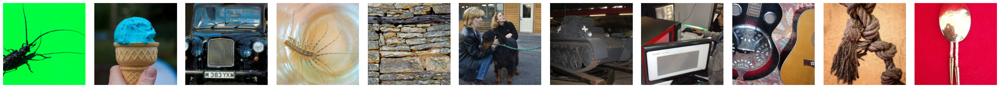

In [62]:
n = len(imgs)
fig, axes = plt.subplots(1, n, figsize=(3*n, 3))  # 1 row, n columns
for i, ax in enumerate(axes):
    ax.imshow(imgs[i])
    ax.axis("off")  # hide axes
plt.tight_layout()
plt.show()